In [20]:
import pandas as pd
import numpy as np
import datasets
import torch
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.metrics import (
    accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, confusion_matrix
)
from sklearn.preprocessing import LabelEncoder
from scipy.special import logsumexp
from scipy.sparse import issparse, csr_matrix
from transformers import EarlyStoppingCallback, AutoTokenizer, AutoConfig, AutoModelForSequenceClassification, DataCollatorWithPadding, Trainer, TrainingArguments
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestClassifier
from tqdm import tqdm
import seaborn as sns
import random



# Task 1: load data

In [21]:
# Load the Emotion dataset

dataset = datasets.load_dataset("google-research-datasets/go_emotions", "simplified")

print("Training size:", dataset['train'].num_rows)
print("Validation size:", dataset['validation'].num_rows)
print("Testing size:", dataset['test'].num_rows)
print("Classes:", dataset['train'].features['labels'])

# Extract the "train" and "test" splits
train_data = dataset["train"]
test_data = dataset["test"]
val_data = dataset["validation"]

Training size: 43410
Validation size: 5426
Testing size: 5427
Classes: Sequence(feature=ClassLabel(names=['admiration', 'amusement', 'anger', 'annoyance', 'approval', 'caring', 'confusion', 'curiosity', 'desire', 'disappointment', 'disapproval', 'disgust', 'embarrassment', 'excitement', 'fear', 'gratitude', 'grief', 'joy', 'love', 'nervousness', 'optimism', 'pride', 'realization', 'relief', 'remorse', 'sadness', 'surprise', 'neutral'], id=None), length=-1, id=None)


In [22]:
def preprocess_data(split_data, label_encoder=None, vectorizer=None, fit=True):

    # Filter single-label data
    simplified_data = [item for item in split_data if len(item["labels"]) == 1]

    # Extract text and single-label values
    texts = [item["text"] for item in simplified_data]
    labels = [item["labels"][0] for item in simplified_data]

    # Encode labels
    if fit:
        label_encoder = LabelEncoder()
        y = label_encoder.fit_transform(labels)
    else:
        y = label_encoder.transform(labels)

    # Vectorize text
    if fit:
        vectorizer = CountVectorizer()
        X = vectorizer.fit_transform(texts)
    else:
        X = vectorizer.transform(texts)

    return X, y, label_encoder, vectorizer

# Process all splits
X_train, y_train, label_encoder, vectorizer = preprocess_data(dataset["train"], fit=True)
X_val, y_val, _, _ = preprocess_data(dataset["validation"], label_encoder=label_encoder, vectorizer=vectorizer, fit=False)
X_test, y_test, _, _ = preprocess_data(dataset["test"], label_encoder=label_encoder, vectorizer=vectorizer, fit=False)

# Class Vis

In [ ]:
# the class names from the dataset
class_names = dataset["train"].features["labels"].feature.names

# the class counts
unique, counts = np.unique(y_train, return_counts=True)
sorted_indices = np.argsort(counts)

# sort the counts and original labels
sorted_counts = counts[sorted_indices]
sorted_labels = [class_names[label] for label in unique[sorted_indices]]

# Create a DataFrame for the table
class_table = pd.DataFrame({
    'Class Label': unique[sorted_indices],
    'Class Name': sorted_labels,
    'Count': sorted_counts
})

# Display the table
class_table

,Class Label,Class Name,Count
0,16,grief,39
1,21,pride,51
2,19,nervousness,85
3,23,relief,88
4,12,embarrassment,203
5,24,remorse,353
6,8,desire,389
7,14,fear,430
8,11,disgust,498
9,13,excitement,510


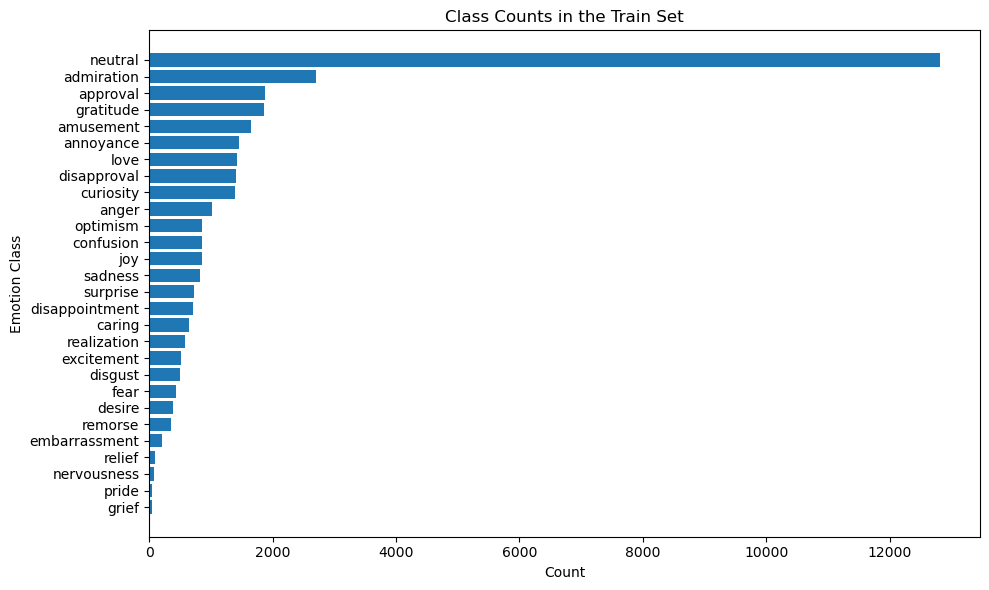

In [ ]:
# Get the class names from the dataset
class_names = dataset["train"].features["labels"].feature.names

# Get the class counts
unique, counts = np.unique(y_train, return_counts=True)
sorted_indices = np.argsort(counts)

# Sort the counts and original labels
sorted_counts = counts[sorted_indices]
sorted_labels = [class_names[label] for label in unique[sorted_indices]]

# Plot the bar chart
plt.figure(figsize=(10, 6))
plt.barh(range(len(sorted_counts)), sorted_counts, tick_label=sorted_labels)
plt.xlabel('Count')
plt.ylabel('Emotion Class')
plt.title('Class Counts in the Train Set')
plt.tight_layout()
plt.show()


# Task 2: Model Fine-Tuning and Fitting

# 2.0 Baseline Random Forest

In [ ]:
# Train a rf
baseline_model = RandomForestClassifier(n_estimators=100, n_jobs=-1, random_state=42)
baseline_model.fit(X_train, y_train)

RandomForestClassifier(n_jobs=-1, random_state=42)

In [ ]:
def calculate_metrics(y_true, y_pred, cm, y_prob=None, average="weighted", power=2):
    metrics = {
        "accuracy": accuracy_score(y_true, y_pred),
        "precision": precision_score(
            y_true, y_pred, average=average, zero_division=0
        ),
        "recall": recall_score(
            y_true, y_pred, average=average, zero_division=0
        ),
        "f1": f1_score(y_true, y_pred, average=average, zero_division=0),
    }

    # Calculate per-class accuracies
    class_totals = cm.sum(axis=1)  
    true_positives = np.diag(cm)   
    per_class_accuracies = true_positives / class_totals  # Per-class accuracies

    # Adjust class weights to reduce impact of minority classes
    class_counts = class_totals
    class_frequencies = class_counts / class_counts.sum()
    class_weights = class_frequencies ** power  # Amplify majority class weights
    class_weights = class_weights / class_weights.sum()  # Normalize weights

    # Compute weighted accuracy
    metrics["weighted_accuracy"] = np.sum(per_class_accuracies * class_weights)

    # AUC (only for probabilistic classifiers)
    if y_prob is not None:
        metrics["auc"] = roc_auc_score(y_true, y_prob, multi_class="ovr")

    return metrics


In [31]:
def calculate_metrics_with_dataframe(y_true, y_pred, cm, y_prob=None, average="weighted", power=2):
    # Calculate overall metrics
    metrics = {
        "accuracy": accuracy_score(y_true, y_pred),
        "precision": precision_score(
            y_true, y_pred, average=average, zero_division=0
        ),
        "recall": recall_score(
            y_true, y_pred, average=average, zero_division=0
        ),
        "f1": f1_score(y_true, y_pred, average=average, zero_division=0),
    }

    # Calculate per-class accuracies, precision, recall, and F1
    class_totals = cm.sum(axis=1)
    true_positives = np.diag(cm)
    per_class_accuracies = true_positives / class_totals

    per_class_precisions = precision_score(y_true, y_pred, average=None, zero_division=0)
    per_class_recalls = recall_score(y_true, y_pred, average=None, zero_division=0)
    per_class_f1s = f1_score(y_true, y_pred, average=None, zero_division=0)

    # Adjust class weights to reduce impact of minority classes
    class_counts = class_totals
    class_frequencies = class_counts / class_counts.sum()
    class_weights = class_frequencies ** power  # Amplify majority class weights
    class_weights = class_weights / class_weights.sum()  # Normalize weights

    # Compute weighted accuracy
    metrics["weighted_accuracy"] = np.sum(per_class_accuracies * class_weights)

    # AUC (only for probabilistic classifiers)
    if y_prob is not None:
        metrics["auc"] = roc_auc_score(y_true, y_prob, multi_class="ovr")

    # Create a DataFrame to store per-class metrics
    class_metrics_df = pd.DataFrame({
        "class": np.arange(len(per_class_accuracies)),
        "accuracy": per_class_accuracies,
        "precision": per_class_precisions,
        "recall": per_class_recalls,
        "f1": per_class_f1s,
    })

    return metrics, class_metrics_df

Results for Train Set:
  Accuracy: 0.9961
  Precision: 0.9961
  Recall: 0.9961
  F1: 0.9961
  Weighted_accuracy: 0.9982
  Auc: 1.0000

Results for Test Set:
  Accuracy: 0.5412
  Precision: 0.5449
  Recall: 0.5412
  F1: 0.4678
  Weighted_accuracy: 0.8315
  Auc: 0.8426



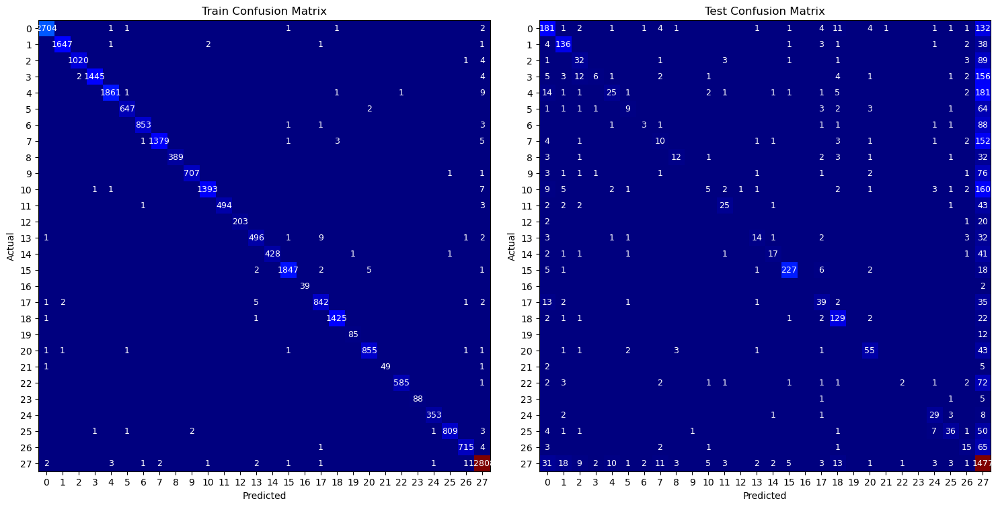

In [ ]:
# Evaluate on Train and Test sets
results = {}
confusion_matrices = {}
df = {}

for set_name, X, y in [('Train', X_train, y_train), ('Test', X_test, y_test)]:
    y_pred = baseline_model.predict(X)
    y_prob = baseline_model.predict_proba(X) if hasattr(baseline_model, "predict_proba") else None

    # Compute confusion matrix
    confusion_matrices[set_name] = confusion_matrix(y, y_pred)

    # Calculate metrics
    metrics, class_df = calculate_metrics_with_dataframe(y, y_pred, confusion_matrices[set_name], y_prob)
    results[set_name] = metrics
    df[set_name] = class_df

# Print results
for set_name, metrics in results.items():
    print(f"Results for {set_name} Set:")
    for metric_name, value in metrics.items():
        print(f"  {metric_name.capitalize()}: {value:.4f}")
    print()

# Plot confusion matrices
fig, axes = plt.subplots(1, 2, figsize=(15, 8))

for i, (set_name, cm) in enumerate(confusion_matrices.items()):
    ax = axes[i]
    ax.imshow(cm, cmap=plt.cm.jet, interpolation='nearest')
    ax.set_title(f'{set_name} Confusion Matrix')
    ax.set_xlabel('Predicted')
    ax.set_ylabel('Actual')
    ax.grid(False)
    ax.set_xticks(np.arange(cm.shape[1]))
    ax.set_yticks(np.arange(cm.shape[0]))

    # Annotate the confusion matrix with counts
    for j in range(cm.shape[0]):
        for k in range(cm.shape[1]):
            count = cm[j, k]
            if count > 0:
                ax.text(k, j, str(count), ha='center', va='center', color='white', fontsize=9)

plt.tight_layout()
plt.show()

In [ ]:
for set, data in df.items():
    print(set)
    display(data)

Train


,class,accuracy,precision,recall,f1
0,0,0.997786,0.997418,0.997786,0.997602
1,1,0.996973,0.998182,0.996973,0.997577
2,2,0.995122,0.998043,0.995122,0.996580
3,3,0.995865,0.998618,0.995865,0.997239
4,4,0.993593,0.996786,0.993593,0.995187
5,5,0.996918,0.993856,0.996918,0.995385
6,6,0.994172,0.996495,0.994172,0.995333
7,7,0.992801,0.998552,0.992801,0.995668
8,8,1.000000,1.000000,1.000000,1.000000
9,9,0.997179,0.997179,0.997179,0.997179


Test


,class,accuracy,precision,recall,f1
0,0,0.520115,0.611486,0.520115,0.562112
1,1,0.731183,0.755556,0.731183,0.743169
2,2,0.244275,0.484848,0.244275,0.324873
3,3,0.030928,0.600000,0.030928,0.058824
4,4,0.105932,0.609756,0.105932,0.180505
5,5,0.104651,0.529412,0.104651,0.174757
6,6,0.030928,0.500000,0.030928,0.058252
7,7,0.056818,0.294118,0.056818,0.095238
8,8,0.214286,0.631579,0.214286,0.320000
9,9,0.000000,0.000000,0.000000,0.000000


# 2.1 Naive Bayes

In [27]:
class NaiveBayes:
    def __init__(self, alpha=1.0):
        self.alpha = alpha

    def fit(self, X, y):
        N, D = X.shape
        self.classes_ = np.unique(y)
        C = len(self.classes_)

        # initialize arrays
        self.class_priors = np.zeros(C)
        self.feature_probs = np.zeros((C, D))

        # class priors and feature probabilities
        for idx, c in enumerate(self.classes_):
            X_c = X[y == c]
            N_c = X_c.shape[0]
            self.class_priors[idx] = N_c / N

            # sum over features
            if issparse(X_c):
                class_feature_counts = X_c.sum(axis=0).A1
            else:
                class_feature_counts = X_c.sum(axis=0)

            # Laplace smoothing
            self.feature_probs[idx, :] = (class_feature_counts + self.alpha) / (N_c + 2 * self.alpha)

    def predict_proba(self, X):
        N, D = X.shape
        C = len(self.classes_)
        log_class_priors = np.log(self.class_priors)

        if issparse(X):
            X = csr_matrix(X)

        # log-posterior probabilities matrix
        log_probs = np.zeros((N, C))

        # log-likelihoods
        for idx in range(C):
            # get feature log-probabilities for class c
            feature_log_probs = np.log(self.feature_probs[idx, :])
            feature_log_probs_neg = np.log(1 - self.feature_probs[idx, :])

            # precompute sum of log(1 - theta_cj)
            log_prob_neg = feature_log_probs_neg.sum()

            # compute log odds
            feature_log_odds = feature_log_probs - feature_log_probs_neg

            # compute log-likelihood
            if issparse(X):
                log_likelihood = log_prob_neg + X.dot(feature_log_odds.T)
            else:
                log_likelihood = log_prob_neg + X @ feature_log_odds.T

            # compute total log-probability for class c
            log_probs[:, idx] = log_class_priors[idx] + log_likelihood

        # log probabilities to probabilities
        log_probs -= logsumexp(log_probs, axis=1, keepdims=True)
        probs = np.exp(log_probs)

        return probs

    def predict(self, X):
        probs = self.predict_proba(X)
        return self.classes_[np.argmax(probs, axis=1)]

    def evaluate_acc(self, y_true, y_pred):
        return np.mean(y_true == y_pred)

    def feature_select(self, X_train, X_test, threshold=0.01):
        # compute the difference between max and min feature probabilities across classes
        feature_prob_diff = self.feature_probs.max(axis=0) - self.feature_probs.min(axis=0)

        # select features where the difference is greater than the threshold
        selected_features = feature_prob_diff >= threshold

        # feature probabilities
        self.feature_probs = self.feature_probs[:, selected_features]

        print(f"Selected {selected_features.sum()} features out of {len(selected_features)}")

        # transform datasets
        X_train_selected = X_train[:, selected_features]
        X_test_selected = X_test[:, selected_features]

        return X_train_selected, X_test_selected


## Hyper-param: alpha

In [28]:
alpha_values = np.logspace(-2, 1, 10)  # Test values from 0.01 to 10

tuning_results = []

for alpha in alpha_values:
    # Initialize and fit Naive Bayes with the current alpha
    nb = NaiveBayes(alpha=alpha)
    nb.fit(X_train, y_train)

    # Evaluate on Train and Test sets
    results = {}

    for set_name, X, y in [('Train', X_train, y_train), ('Val', X_val, y_val)]:
        # Predictions and probabilities
        y_pred = nb.predict(X)
        y_prob = nb.predict_proba(X)

        # Calculate accuracy
        accuracy = nb.evaluate_acc(y, y_pred)
        results[set_name] = accuracy


    # Store results for this alpha
    tuning_results.append({
        'alpha': alpha,
        'train_accuracy': results['Train'],
        'val_accuracy': results['Val'],
    })

    # Print results for the current alpha
    print(f"Alpha: {alpha:.4f}, Train Accuracy: {results['Train']:.4f}, "
          f"Validation Accuracy: {results['Val']:.4f}")

best_result = max(tuning_results, key=lambda x: x['val_accuracy'])

print("\nBest Alpha Hyperparameter Tuning Result:")
print(f"Alpha: {best_result['alpha']:.4f}")
print(f"Train Accuracy: {best_result['train_accuracy']:.4f}")
print(f"Validation Accuracy: {best_result['val_accuracy']:.4f}")


Alpha: 0.0100, Train Accuracy: 0.8298, Validation Accuracy: 0.4114
Alpha: 0.0215, Train Accuracy: 0.8233, Validation Accuracy: 0.4274
Alpha: 0.0464, Train Accuracy: 0.8079, Validation Accuracy: 0.4380
Alpha: 0.1000, Train Accuracy: 0.7751, Validation Accuracy: 0.4512
Alpha: 0.2154, Train Accuracy: 0.6954, Validation Accuracy: 0.4545
Alpha: 0.4642, Train Accuracy: 0.5496, Validation Accuracy: 0.4268
Alpha: 1.0000, Train Accuracy: 0.4006, Validation Accuracy: 0.3661
Alpha: 2.1544, Train Accuracy: 0.3545, Validation Accuracy: 0.3507
Alpha: 4.6416, Train Accuracy: 0.3532, Validation Accuracy: 0.3500
Alpha: 10.0000, Train Accuracy: 0.3532, Validation Accuracy: 0.3500

Best Alpha Hyperparameter Tuning Result:
Alpha: 0.2154
Train Accuracy: 0.6954
Validation Accuracy: 0.4545


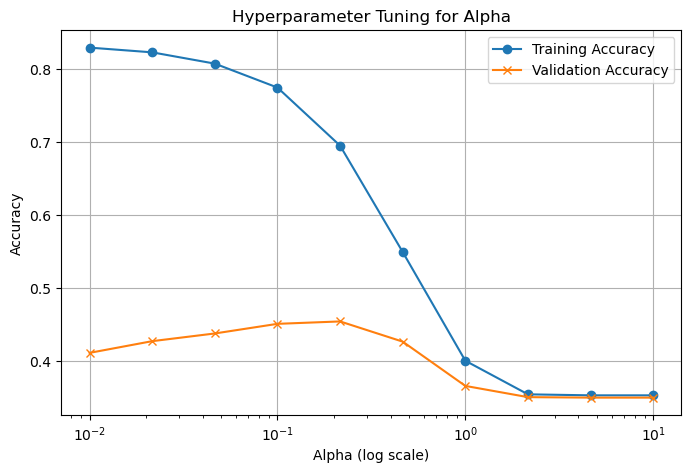

In [ ]:
train_accuracies = [result['train_accuracy'] for result in tuning_results]
val_accuracies = [result['val_accuracy'] for result in tuning_results]

plt.figure(figsize=(8, 5))
plt.plot(alpha_values, train_accuracies, marker='o', label='Training Accuracy')
plt.plot(alpha_values, val_accuracies, marker='x', label='Validation Accuracy')
plt.xscale('log')
plt.xlabel('Alpha (log scale)')
plt.ylabel('Accuracy')
plt.title('Hyperparameter Tuning for Alpha')
plt.legend()
plt.grid()
plt.show()

## Fit the Tuned Model

In [29]:
# Initialize and fit tuned Naive Bayes
nb = NaiveBayes(alpha=best_result['alpha'])
nb.fit(X_train, y_train)

Results for Train Set:
  Accuracy: 0.6954
  Precision: 0.7514
  Recall: 0.6954
  F1: 0.6712
  Weighted_accuracy: 0.8921
  Auc: 0.9657

Results for Test Set:
  Accuracy: 0.4449
  Precision: 0.4065
  Recall: 0.4449
  F1: 0.3689
  Weighted_accuracy: 0.7496
  Auc: 0.8199



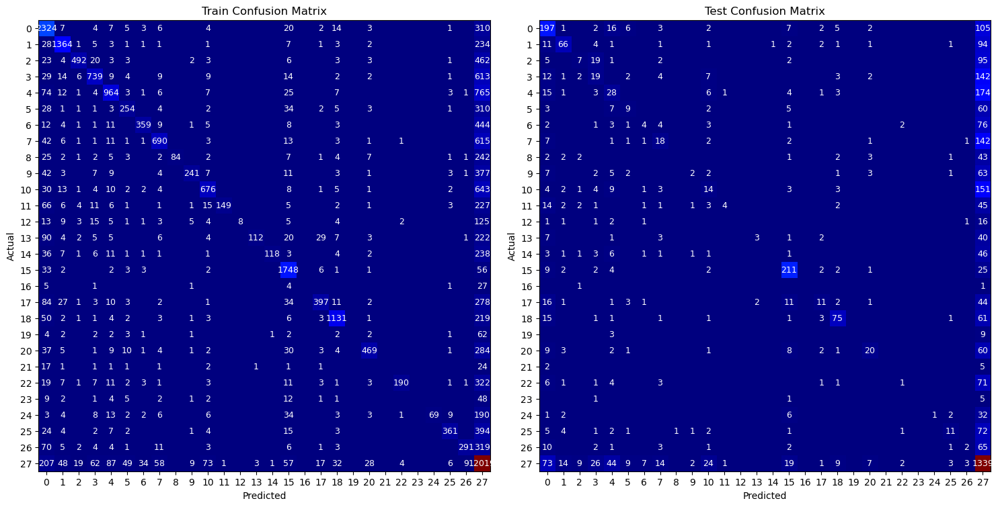

In [32]:
# Evaluate on Train and Test sets
results = {}
confusion_matrices = {}
df1 = {}

for set_name, X, y in [('Train', X_train, y_train), ('Test', X_test, y_test)]:
    y_pred = nb.predict(X)
    y_prob = nb.predict_proba(X) if hasattr(nb, "predict_proba") else None

    # Compute confusion matrix
    confusion_matrices[set_name] = confusion_matrix(y, y_pred)

    # Calculate metrics
    metrics, class_df = calculate_metrics_with_dataframe(y, y_pred, confusion_matrices[set_name], y_prob)
    results[set_name] = metrics
    df1[set_name] = class_df

# Print results
for set_name, metrics in results.items():
    print(f"Results for {set_name} Set:")
    for metric_name, value in metrics.items():
        print(f"  {metric_name.capitalize()}: {value:.4f}")
    print()

# Plot confusion matrices
fig, axes = plt.subplots(1, 2, figsize=(15, 8))

for i, (set_name, cm) in enumerate(confusion_matrices.items()):
    ax = axes[i]
    ax.imshow(cm, cmap=plt.cm.jet, interpolation='nearest')
    ax.set_title(f'{set_name} Confusion Matrix')
    ax.set_xlabel('Predicted')
    ax.set_ylabel('Actual')
    ax.grid(False)
    ax.set_xticks(np.arange(cm.shape[1]))
    ax.set_yticks(np.arange(cm.shape[0]))

    # Annotate the confusion matrix with counts
    for j in range(cm.shape[0]):
        for k in range(cm.shape[1]):
            count = cm[j, k]
            if count > 0:
                ax.text(k, j, str(count), ha='center', va='center', color='white', fontsize=9)

plt.tight_layout()
plt.show()

In [38]:
true_label_15_to_17 = np.sum((y_test == 15) & (y_pred == 17))
true_label_17_to_15 = np.sum((y_test == 17) & (y_pred == 15))

print(f"Number of predictions where true label is 15 but misclassified as 17: {true_label_15_to_17}")
print(f"Number of predictions where true label is 17 but misclassified as 15: {true_label_17_to_15}")

Number of predictions where true label is 15 but misclassified as 17: 2
Number of predictions where true label is 17 but misclassified as 15: 11


In [ ]:
for set, data in df1.items():
    print(set)
    display(data)

Train


,class,accuracy,precision,recall,f1
0,0,0.857565,0.678738,0.857565,0.757744
1,1,0.825666,0.871565,0.825666,0.847995
2,2,0.480000,0.912801,0.480000,0.629156
3,3,0.509304,0.805011,0.509304,0.623892
4,4,0.514682,0.792763,0.514682,0.624150
5,5,0.391371,0.701657,0.391371,0.502473
6,6,0.418415,0.869249,0.418415,0.564910
7,7,0.496760,0.827338,0.496760,0.620783
8,8,0.215938,1.000000,0.215938,0.355180
9,9,0.339915,0.909434,0.339915,0.494867


Test


,class,accuracy,precision,recall,f1
0,0,0.566092,0.451835,0.566092,0.502551
1,1,0.354839,0.634615,0.354839,0.455172
2,2,0.053435,0.280000,0.053435,0.089744
3,3,0.097938,0.204301,0.097938,0.132404
4,4,0.118644,0.197183,0.118644,0.148148
5,5,0.104651,0.257143,0.104651,0.148760
6,6,0.041237,0.235294,0.041237,0.070175
7,7,0.102273,0.295082,0.102273,0.151899
8,8,0.000000,0.000000,0.000000,0.000000
9,9,0.022727,0.285714,0.022727,0.042105


# 2.2 BERT

## Fine Tune

In [ ]:
# Set seed for reproducibility
def set_seed(seed):
    random.seed(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed_all(seed)

set_seed(42)

# Load pretrained model and tokenizer
bert_path = "bert-base-uncased"
tokenizer = AutoTokenizer.from_pretrained(bert_path)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Preprocess dataset
def preprocess_data(split):
    texts = [item["text"] for item in dataset[split] if len(item["labels"]) == 1]
    labels = [item["labels"][0] for item in dataset[split] if len(item["labels"]) == 1]
    encodings = tokenizer(texts, truncation=True, padding=False, max_length=256)
    return encodings, labels

train_encodings, train_labels = preprocess_data("train")
val_encodings, val_labels = preprocess_data("validation")
test_encodings, test_labels = preprocess_data("test")

# Dataset wrapper
class GoEmotionsDataset(torch.utils.data.Dataset):
    def __init__(self, encodings, labels):
        self.encodings = encodings
        self.labels = labels

    def __len__(self):
        return len(self.labels)

    def __getitem__(self, idx):
        # Return a dictionary without converting to tensors
        item = {key: val[idx] for key, val in self.encodings.items()}
        item["labels"] = self.labels[idx]
        return item

train_dataset = GoEmotionsDataset(train_encodings, train_labels)
val_dataset = GoEmotionsDataset(val_encodings, val_labels)
test_dataset = GoEmotionsDataset(test_encodings, test_labels)

tokenizer_config.json:   0%|          | 0.00/48.0 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/570 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/232k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/466k [00:00<?, ?B/s]

## Find the Optimal Learning Rate

In [ ]:
# Define data collator
set_seed(42)

data_collator = DataCollatorWithPadding(tokenizer)

# Define compute_metrics function
def compute_metrics(eval_pred):
    logits, labels = eval_pred.predictions, eval_pred.label_ids
    preds = np.argmax(logits, axis=1)
    return {"accuracy": accuracy_score(labels, preds)}

# Define learning_rate values to test
learning_rate_values = [2e-5, 5e-5]
best_learning_rate = None
best_val_accuracy = 0
batch_size = 32
model_save_path = "./best_bert_model"

for learning_rate in learning_rate_values:
    print(f"Training with learning_rate={learning_rate}...")

    # Re-initialize the model for each learning rate
    model = AutoModelForSequenceClassification.from_pretrained(bert_path, num_labels=28).to(device)

    # Define training arguments
    training_args = TrainingArguments(
        output_dir="./results",
        evaluation_strategy="epoch",
        save_strategy="no",
        learning_rate=learning_rate,
        per_device_train_batch_size=batch_size,
        per_device_eval_batch_size=batch_size,
        num_train_epochs=2,
        weight_decay=0,
        logging_dir="./logs",
        disable_tqdm=False,
        logging_steps=10,
        fp16=True,
        seed=42,
    )

    # Trainer instance
    trainer = Trainer(
        model=model,
        args=training_args,
        train_dataset=train_dataset,
        eval_dataset=val_dataset,
        data_collator=data_collator,
        compute_metrics=compute_metrics,
    )

    # Train and evaluate
    trainer.train()
    val_preds = trainer.predict(val_dataset)
    val_logits, val_labels = val_preds.predictions, val_preds.label_ids
    val_accuracy = accuracy_score(val_labels, np.argmax(val_logits, axis=1))
    print(f"Validation Accuracy for learning_rate={learning_rate}: {val_accuracy:.4f}")

    # Save the best model based on validation accuracy
    if val_accuracy > best_val_accuracy:
        best_val_accuracy = val_accuracy
        best_learning_rate = learning_rate
        # Save the model
        trainer.save_model(model_save_path)  # Save model and tokenizer

    # Clear GPU cache to free up memory
    torch.cuda.empty_cache()

print(f"Best learning_rate based on validation accuracy: {best_learning_rate}")

# Save the tokenizer (if not already saved)
tokenizer.save_pretrained(model_save_path)

Training with learning_rate=2e-05...


model.safetensors:   0%|          | 0.00/440M [00:00<?, ?B/s]

Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
/usr/local/lib/python3.10/dist-packages/transformers/training_args.py:1568: FutureWarning: `evaluation_strategy` is deprecated and will be removed in version 4.46 of 🤗 Transformers. Use `eval_strategy` instead
  warnings.warn(
wandb: WARNING The `run_name` is currently set to the same value as `TrainingArguments.output_dir`. If this was not intended, please specify a different run name by setting the `TrainingArguments.run_name` parameter.
wandb: Using wandb-core as the SDK backend.  Please refer to https://wandb.me/wandb-core for more information.


<IPython.core.display.Javascript object>

wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


Epoch,Training Loss,Validation Loss,Accuracy
1,1.221700,1.344669,0.605321
2,1.342700,1.290215,0.616755


Validation Accuracy for learning_rate=2e-05: 0.6168


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Training with learning_rate=5e-05...


/usr/local/lib/python3.10/dist-packages/transformers/training_args.py:1568: FutureWarning: `evaluation_strategy` is deprecated and will be removed in version 4.46 of 🤗 Transformers. Use `eval_strategy` instead
  warnings.warn(


Epoch,Training Loss,Validation Loss,Accuracy
1,1.186400,1.263065,0.625110
2,1.155200,1.242414,0.622471


Validation Accuracy for learning_rate=5e-05: 0.6225
Best learning_rate based on validation accuracy: 5e-05


('./best_bert_model/tokenizer_config.json',
 './best_bert_model/special_tokens_map.json',
 './best_bert_model/vocab.txt',
 './best_bert_model/added_tokens.json',
 './best_bert_model/tokenizer.json')

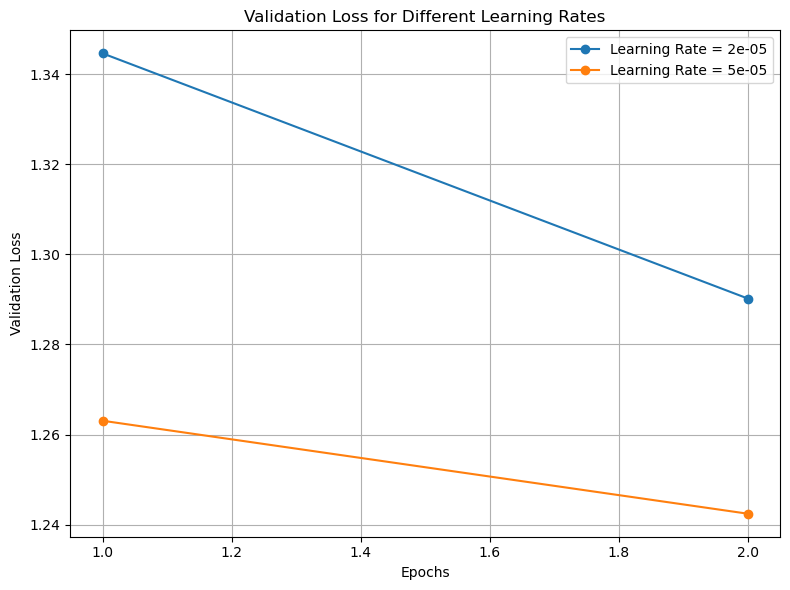

In [70]:
# Data for the learning rates
epochs = [1, 2]
loss_lr_2e5 = [1.344669, 1.290215]
loss_lr_5e5 = [1.263065, 1.242414]

# Create the plot
plt.figure(figsize=(8, 6))
plt.plot(epochs, loss_lr_2e5, marker='o', label='Learning Rate = 2e-05')
plt.plot(epochs, loss_lr_5e5, marker='o', label='Learning Rate = 5e-05')

# Add labels, title, and legend
plt.xlabel('Epochs')
plt.ylabel('Validation Loss')
plt.title('Validation Loss for Different Learning Rates')
plt.legend()
plt.grid(True)
plt.tight_layout()

# Show the plot
plt.show()


## Step-wise Fine Tune

In [ ]:
model_save_path = "./bert_model"
set_seed(42)
batch_size = 32
data_collator = DataCollatorWithPadding(tokenizer)

# Define compute_metrics function
def compute_metrics(eval_pred):
    logits, labels = eval_pred.predictions, eval_pred.label_ids
    preds = np.argmax(logits, axis=1)
    return {"accuracy": accuracy_score(labels, preds)}

model = AutoModelForSequenceClassification.from_pretrained(bert_path, num_labels=28).to(device)

# Freeze all BERT layers
for param in model.bert.parameters():
    param.requires_grad = False

  # Define training arguments
training_args_stage_1 = TrainingArguments(
        output_dir="./results_stage_1",
        eval_strategy="epoch",
        save_strategy="epoch",
        learning_rate=1e-3,
        per_device_train_batch_size=batch_size,
        per_device_eval_batch_size=batch_size,
        load_best_model_at_end=True,
        num_train_epochs=10,
        warmup_steps=500,
        lr_scheduler_type="linear",
        logging_dir="./logs",
        disable_tqdm=False,
        logging_steps=10,
        fp16=True,
        seed=42,
    )

# Train only the classifier
trainer_stage_1 = Trainer(
    model=model,
    args=training_args_stage_1,
    train_dataset=train_dataset,
    eval_dataset=val_dataset,
    data_collator=data_collator,
    callbacks=[EarlyStoppingCallback(early_stopping_patience=1)],
    compute_metrics=compute_metrics,
)

trainer_stage_1.train()

Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,2.386800,2.361234,0.372252
2,2.357100,2.239151,0.387423
3,2.234100,2.142562,0.414248
4,2.191200,2.116484,0.415128
5,2.025100,2.113554,0.408531
6,2.188300,2.055348,0.430519
7,2.089800,2.037261,0.430299
8,2.138700,2.022786,0.428320
9,2.118000,2.020129,0.429420
10,1.980500,2.004894,0.429859


TrainOutput(global_step=11350, training_loss=2.2045538314953776, metrics={'train_runtime': 493.4679, 'train_samples_per_second': 735.772, 'train_steps_per_second': 23.0, 'total_flos': 6802593209523648.0, 'train_loss': 2.2045538314953776, 'epoch': 10.0})

In [ ]:
# Define training arguments
training_args_stage_2 = TrainingArguments(
        output_dir="./results_stage_2",
        eval_strategy="epoch",
        save_strategy="epoch",
        learning_rate=1e-3,
        per_device_train_batch_size=batch_size,
        per_device_eval_batch_size=batch_size,
        load_best_model_at_end=True,
        num_train_epochs=10,
        warmup_steps=500,
        lr_scheduler_type="linear",
        logging_dir="./logs",
        disable_tqdm=False,
        logging_steps=10,
        fp16=True,
        seed=42,
    )

# Train only the classifier
trainer_stage_2 = Trainer(
    model=model,
    args=training_args_stage_2,
    train_dataset=train_dataset,
    eval_dataset=val_dataset,
    data_collator=data_collator,
    callbacks=[EarlyStoppingCallback(early_stopping_patience=1)],
    compute_metrics=compute_metrics,
)

trainer_stage_2.train()

Epoch,Training Loss,Validation Loss,Accuracy
1,2.074400,2.052296,0.436236
2,2.199000,2.046485,0.424362
3,2.126800,1.992657,0.436895
4,2.110600,1.997445,0.437335


TrainOutput(global_step=4540, training_loss=2.1031067696962062, metrics={'train_runtime': 169.28, 'train_samples_per_second': 2144.849, 'train_steps_per_second': 67.049, 'total_flos': 2720368661235264.0, 'train_loss': 2.1031067696962062, 'epoch': 4.0})

In [ ]:
set_seed(42)

for param in model.bert.parameters():
    param.requires_grad = True

# Adjust training arguments for fine-tuning
training_args_stage_3 = TrainingArguments(
    output_dir="./results_stage_3",
    eval_strategy="epoch",
    save_strategy="epoch",
    learning_rate=5e-5,  
    per_device_train_batch_size=batch_size,
    per_device_eval_batch_size=batch_size,
    load_best_model_at_end=True,
    num_train_epochs=4,
    warmup_steps=500,
    lr_scheduler_type="linear",
    logging_dir="./logs_stage_2",
    disable_tqdm=False,
    logging_steps=10,
    fp16=True,
    seed=42,
)

# Fine-tune the entire model
trainer_stage_3 = Trainer(
    model=model,
    args=training_args_stage_3,
    train_dataset=train_dataset,
    eval_dataset=val_dataset,
    data_collator=data_collator,
    callbacks=[EarlyStoppingCallback(early_stopping_patience=1)],
    compute_metrics=compute_metrics,
)

trainer_stage_3.train()

# Train and evaluate
trainer_stage_3.save_model(model_save_path)
tokenizer.save_pretrained(model_save_path)

Epoch,Training Loss,Validation Loss,Accuracy
1,1.161000,1.225147,0.623351
2,1.138700,1.218923,0.625110
3,0.736400,1.409015,0.600264


('./bert_model/tokenizer_config.json',
 './bert_model/special_tokens_map.json',
 './bert_model/vocab.txt',
 './bert_model/added_tokens.json',
 './bert_model/tokenizer.json')

## Evaluation

In [45]:
# change train and test format
def preprocess_data(split_data):
    simplified_data = [item for item in split_data if len(item["labels"]) == 1]

    texts = [item["text"] for item in simplified_data]
    labels = [item["labels"][0] for item in simplified_data]

    return texts, labels

X_train, y_train = preprocess_data(train_data)
X_test, y_test = preprocess_data(test_data)

## Eval Func Definition

In [ ]:
# func to process data in batches
def evaluate_model(model, tokenizer, X, y, batch_size=16):

    model.eval()  # Set the model to evaluation mode

    y_true = []
    y_pred = []
    y_prob = []

    # Process data in batches
    for i in tqdm(range(0, len(X), batch_size)):
        batch_X = X[i:i + batch_size]
        batch_y = y[i:i + batch_size]

        # Tokenize the batch
        inputs = tokenizer(batch_X, truncation=True, padding=True, return_tensors="pt", max_length=256)
        inputs = {key: val for key, val in inputs.items()}

        # Get model predictions
        with torch.no_grad():
            outputs = model(**inputs)
            logits = outputs.logits
            batch_y_pred = torch.argmax(logits, axis=1).numpy()
            batch_y_prob = torch.softmax(logits, dim=1).numpy()

        # Append batch results
        y_true.extend(batch_y)
        y_pred.extend(batch_y_pred)
        y_prob.extend(batch_y_prob)

    return y_true, y_pred, y_prob

## Pre-trained model

In [40]:
# load the pretrained model and tokenizer
model_name = "bert-base-uncased"
pretrained_model = AutoModelForSequenceClassification.from_pretrained(model_name, num_labels=28)
pretrained_tokenizer = AutoTokenizer.from_pretrained(model_name)

Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


100%|██████████| 287/287 [01:52<00:00,  2.56it/s]


Results for Train Set:
  Accuracy: 0.0345
  Precision: 0.0039
  Recall: 0.0345
  F1: 0.0042
  Weighted_accuracy: 0.0086
  Auc: 0.5106

Results for Test Set:
  Accuracy: 0.0333
  Precision: 0.0050
  Recall: 0.0333
  F1: 0.0047
  Weighted_accuracy: 0.0089
  Auc: 0.5176



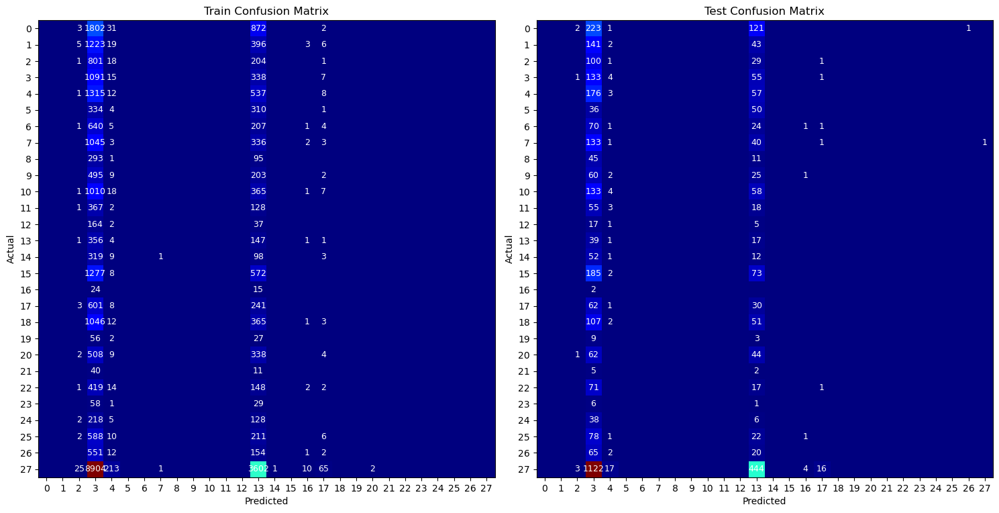

In [ ]:
# Evaluate on Train and Test sets
results = {}
confusion_matrices = {}
df2 = {}

for set_name, X, y in [('Train', X_train, y_train), ('Test', X_test, y_test)]:
    y_true, y_pred, y_prob = evaluate_model(pretrained_model, pretrained_tokenizer, X, y, batch_size=16)

    # Compute confusion matrix
    confusion_matrices[set_name] = confusion_matrix(y, y_pred)

    # Calculate metrics
    metrics, class_df = calculate_metrics_with_dataframe(y, y_pred, confusion_matrices[set_name], y_prob)
    results[set_name] = metrics
    df2[set_name] = class_df

# Print results
for set_name, metrics in results.items():
    print(f"Results for {set_name} Set:")
    for metric_name, value in metrics.items():
        print(f"  {metric_name.capitalize()}: {value:.4f}")
    print()

# Plot confusion matrices
fig, axes = plt.subplots(1, 2, figsize=(15, 8))

for i, (set_name, cm) in enumerate(confusion_matrices.items()):
    ax = axes[i]
    ax.imshow(cm, cmap=plt.cm.jet, interpolation='nearest')
    ax.set_title(f'{set_name} Confusion Matrix')
    ax.set_xlabel('Predicted')
    ax.set_ylabel('Actual')
    ax.grid(False)
    ax.set_xticks(np.arange(cm.shape[1]))
    ax.set_yticks(np.arange(cm.shape[0]))

    # Annotate the confusion matrix with counts
    for j in range(cm.shape[0]):
        for k in range(cm.shape[1]):
            count = cm[j, k]
            if count > 0:
                ax.text(k, j, str(count), ha='center', va='center', color='white', fontsize=9)

plt.tight_layout()
plt.show()

In [ ]:
for set, data in df2.items():
    print(set)
    display(data)

Train


,class,accuracy,precision,recall,f1
0,0,0.000000,0.000000,0.000000,0.000000
1,1,0.000000,0.000000,0.000000,0.000000
2,2,0.000976,0.020408,0.000976,0.001862
3,3,0.751895,0.042709,0.751895,0.080827
4,4,0.006407,0.026906,0.006407,0.010349
5,5,0.000000,0.000000,0.000000,0.000000
6,6,0.000000,0.000000,0.000000,0.000000
7,7,0.000000,0.000000,0.000000,0.000000
8,8,0.000000,0.000000,0.000000,0.000000
9,9,0.000000,0.000000,0.000000,0.000000


Test


,class,accuracy,precision,recall,f1
0,0,0.000000,0.000000,0.000000,0.000000
1,1,0.000000,0.000000,0.000000,0.000000
2,2,0.000000,0.000000,0.000000,0.000000
3,3,0.685567,0.041240,0.685567,0.077801
4,4,0.012712,0.060000,0.012712,0.020979
5,5,0.000000,0.000000,0.000000,0.000000
6,6,0.000000,0.000000,0.000000,0.000000
7,7,0.000000,0.000000,0.000000,0.000000
8,8,0.000000,0.000000,0.000000,0.000000
9,9,0.000000,0.000000,0.000000,0.000000


## Fine-Tuned

In [44]:
# Load the model and tokenizer
model_path = r"D:\PPT&WORD\McGill\COMP551\python_workspace\bert"
model = AutoModelForSequenceClassification.from_pretrained(model_path, use_safetensors=True)
tokenizer = AutoTokenizer.from_pretrained(model_path)

100%|██████████| 287/287 [02:06<00:00,  2.26it/s]


Results for Train Set:
  Accuracy: 0.7739
  Precision: 0.7837
  Recall: 0.7739
  F1: 0.7662
  Weighted_accuracy: 0.8337
  Auc: 0.9871

Results for Test Set:
  Accuracy: 0.6303
  Precision: 0.6264
  Recall: 0.6303
  F1: 0.6133
  Weighted_accuracy: 0.7279
  Auc: 0.9390



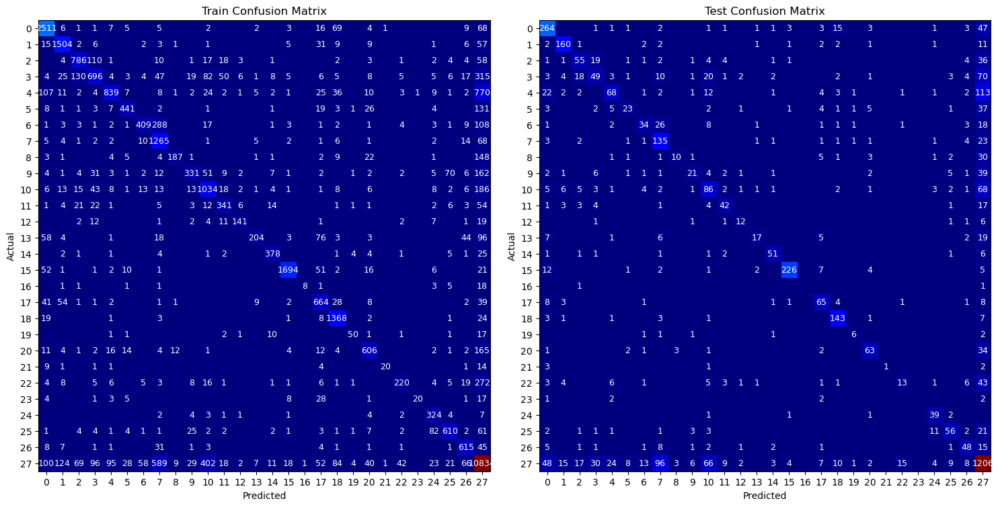

In [ ]:
# Evaluate on Train and Test sets
results = {}
confusion_matrices = {}
df3 = {}

for set_name, X, y in [('Train', X_train, y_train), ('Test', X_test, y_test)]:
    y_true, y_pred, y_prob = evaluate_model(model, tokenizer, X, y, batch_size=16)

    # Compute confusion matrix
    confusion_matrices[set_name] = confusion_matrix(y, y_pred)

    # Calculate metrics
    metrics, class_df = calculate_metrics_with_dataframe(y, y_pred, confusion_matrices[set_name], y_prob)
    results[set_name] = metrics
    df3[set_name] = class_df

# Print results
for set_name, metrics in results.items():
    print(f"Results for {set_name} Set:")
    for metric_name, value in metrics.items():
        print(f"  {metric_name.capitalize()}: {value:.4f}")
    print()

# Plot confusion matrices
fig, axes = plt.subplots(1, 2, figsize=(15, 8))

for i, (set_name, cm) in enumerate(confusion_matrices.items()):
    ax = axes[i]
    ax.imshow(cm, cmap=plt.cm.jet, interpolation='nearest')
    ax.set_title(f'{set_name} Confusion Matrix')
    ax.set_xlabel('Predicted')
    ax.set_ylabel('Actual')
    ax.grid(False)
    ax.set_xticks(np.arange(cm.shape[1]))
    ax.set_yticks(np.arange(cm.shape[0]))

    # Annotate the confusion matrix with counts
    for j in range(cm.shape[0]):
        for k in range(cm.shape[1]):
            count = cm[j, k]
            if count > 0:
                ax.text(k, j, str(count), ha='center', va='center', color='white', fontsize=9)

plt.tight_layout()
plt.show()

In [ ]:
for set, data in df3.items():
    print(set)
    display(data)

Train


,class,accuracy,precision,recall,f1
0,0,0.926568,0.844886,0.926568,0.883844
1,1,0.910412,0.843522,0.910412,0.875691
2,2,0.766829,0.752153,0.766829,0.759420
3,3,0.479669,0.667306,0.479669,0.558140
4,4,0.447944,0.831516,0.447944,0.582235
5,5,0.679507,0.836812,0.679507,0.750000
6,6,0.476690,0.811508,0.476690,0.600587
7,7,0.910727,0.545024,0.910727,0.681941
8,8,0.480720,0.886256,0.480720,0.623333
9,9,0.466855,0.753986,0.466855,0.576655


Test


,class,accuracy,precision,recall,f1
0,0,0.758621,0.658354,0.758621,0.704940
1,1,0.860215,0.800000,0.860215,0.829016
2,2,0.419847,0.514019,0.419847,0.462185
3,3,0.252577,0.415254,0.252577,0.314103
4,4,0.288136,0.586207,0.288136,0.386364
5,5,0.267442,0.575000,0.267442,0.365079
6,6,0.350515,0.548387,0.350515,0.427673
7,7,0.767045,0.447020,0.767045,0.564854
8,8,0.178571,0.625000,0.178571,0.277778
9,9,0.238636,0.552632,0.238636,0.333333


# Task 3: Attention Matrix Vis

## Funcs for Extraction and Vis

In [50]:
# set to True for attention outputs
model.config.output_attentions = True

# extract attention matrix
def get_attention_matrices(model, tokenizer, text):
    # Tokenize the input text
    inputs = tokenizer(text, return_tensors="pt", truncation=True, max_length=512)
    inputs = {key: val for key, val in inputs.items()}

    # Forward pass with attention outputs
    with torch.no_grad():
        outputs = model(**inputs)

    # Get attention matrices and tokenized inputs
    attentions = outputs.attentions  # List of attention matrices (one per layer)
    tokenized_input = tokenizer.convert_ids_to_tokens(inputs["input_ids"][0].numpy())

    return attentions, tokenized_input


In [ ]:
# heatmap vis
def visualize_attention_multiple(attentions, tokens, layers, heads, figsize=(25, 20)):

    num_layers = len(layers)
    num_heads = len(heads)

    # Create a grid of subplots
    fig, axes = plt.subplots(num_layers, num_heads, figsize=figsize, squeeze=False)

    for i, layer in enumerate(layers):
        for j, head in enumerate(heads):
            ax = axes[i, j]

            # Get the attention matrix for the specified layer and head
            attention_matrix = attentions[layer][0][head].numpy()

            # Plot the heatmap
            sns.heatmap(
                attention_matrix,
                xticklabels=tokens,
                yticklabels=tokens,
                cmap="viridis",
                annot=True,  # Add numbers to each square
                fmt=".2f",   # Format for numbers
                cbar=False,  # Suppress color bar for clarity
                ax=ax
            )

            # Set titles and labels
            ax.set_title(f"Layer {layer}, Head {head}")
            ax.set_xlabel("Input Tokens")
            ax.set_ylabel("Input Tokens")
            ax.tick_params(axis="x", labelrotation=90)

    # Adjust layout
    plt.tight_layout()
    plt.show()

In [46]:
# get predictions from test set
def get_predictions_and_labels(model, tokenizer, X, y, batch_size=16):
    model.eval()

    y_true = []
    y_pred = []
    y_prob = []

    for i in tqdm(range(0, len(X), batch_size), desc="Generating predictions"):
        batch_X = X[i:i + batch_size]
        batch_y = y[i:i + batch_size]

        # Tokenize the batch
        inputs = tokenizer(batch_X, truncation=True, padding=True, return_tensors="pt", max_length=512)
        inputs = {key: val for key, val in inputs.items()}

        # Get predictions
        with torch.no_grad():
            outputs = model(**inputs)
            logits = outputs.logits
            batch_y_pred = torch.argmax(logits, axis=1).numpy()
            batch_y_prob = torch.softmax(logits, dim=1).numpy()

        # Append results
        y_true.extend(batch_y)
        y_pred.extend(batch_y_pred)
        y_prob.extend(batch_y_prob)

    return y_true, y_pred, y_prob

# predictions for test sets
y_test_true, y_test_pred, y_test_prob = get_predictions_and_labels(model, tokenizer, X_test, y_test)


Generating predictions: 100%|██████████| 287/287 [02:02<00:00,  2.35it/s]


In [47]:
# separate correct rows from incorrect ones
def separate_correct_incorrect(X, y_true, y_pred):
    correctly_classified = [(text, true, pred) for text, true, pred in zip(X, y_true, y_pred) if true == pred]
    incorrectly_classified = [(text, true, pred) for text, true, pred in zip(X, y_true, y_pred) if true != pred]
    return correctly_classified, incorrectly_classified


# Separate Test set
correct_test, incorrect_test = separate_correct_incorrect(X_test, y_test_true, y_test_pred)

# Example output
print(f"Sample correct: {correct_test[:1]}")
print(f"Sample incorrect: {incorrect_test[:1]}")

Sample correct: [("I didn't know that, thank you for teaching me something today!", 15, 15)]
Sample incorrect: [('I’m really sorry about your situation :( Although I love the names Sapphira, Cirilla, and Scarlett!', 25, 24)]


## Attention Matrix Vis

In [14]:
from bertviz import model_view

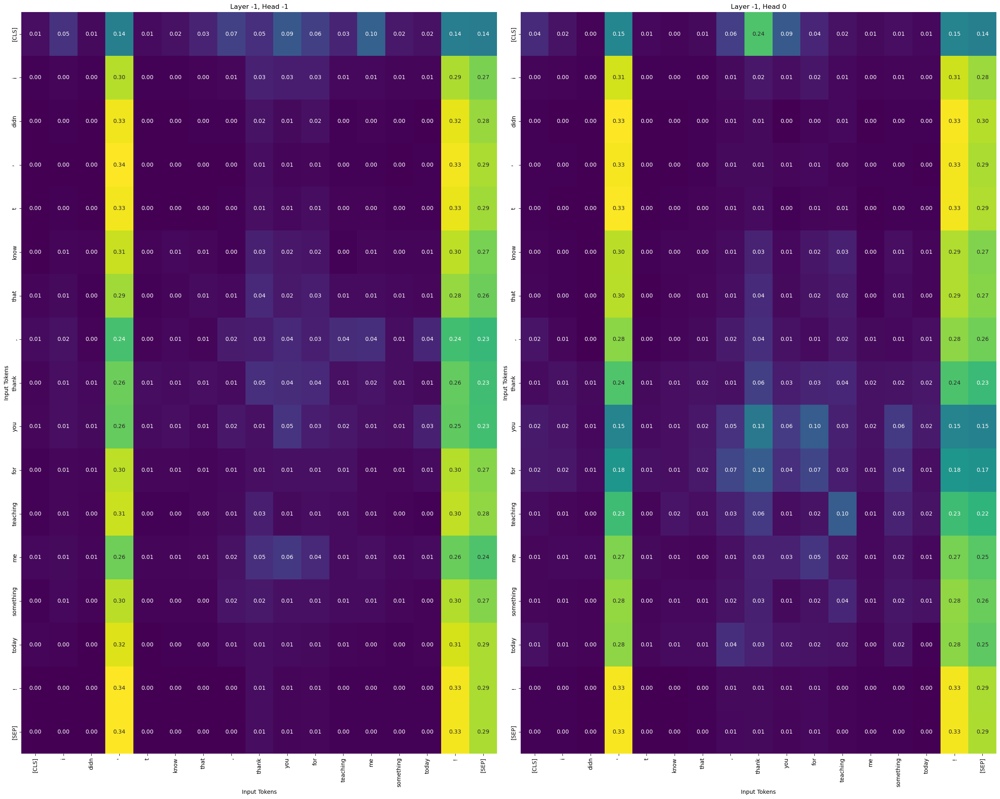

In [ ]:
# vis
attentions, tokens = get_attention_matrices(model, tokenizer, correct_test[:1][0][0])

layers_to_visualize = [-1]
heads_to_visualize = [-1,0]

# Visualize attention
visualize_attention_multiple(attentions, tokens, layers_to_visualize, heads_to_visualize)


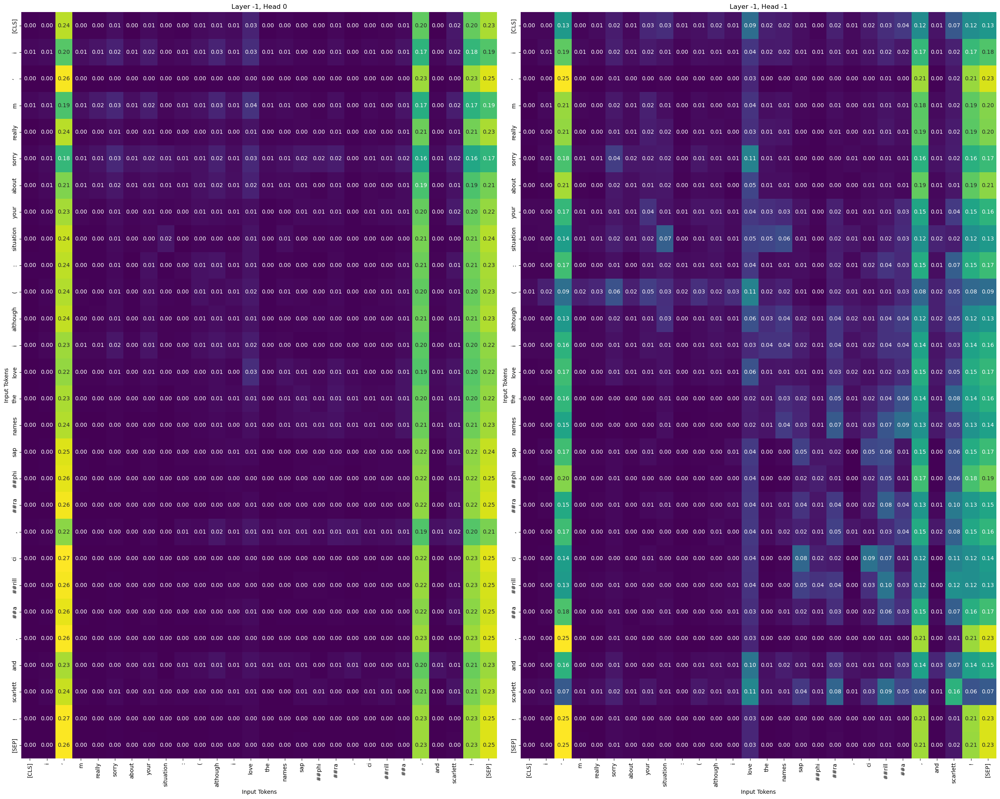

In [ ]:
# vis
attentions, tokens = get_attention_matrices(model, tokenizer, incorrect_test[:1][0][0])

layers_to_visualize = [-1]
heads_to_visualize = [0, -1]

# Visualize attention
visualize_attention_multiple(attentions, tokens, layers_to_visualize, heads_to_visualize)

# GBT2

In [17]:
# Load the model and tokenizer
model_path = r"D:\PPT&WORD\McGill\COMP551\python_workspace\gbt2"
gbt_model = AutoModelForSequenceClassification.from_pretrained(model_path, use_safetensors=True)
gbt_tokenizer = AutoTokenizer.from_pretrained(model_path)

100%|██████████| 287/287 [02:08<00:00,  2.24it/s]


Results for Train Set:
  Accuracy: 0.8480
  Precision: 0.8493
  Recall: 0.8480
  F1: 0.8444
  Weighted_accuracy: 0.8911
  Auc: 0.9933

Results for Test Set:
  Accuracy: 0.5959
  Precision: 0.5849
  Recall: 0.5959
  F1: 0.5829
  Weighted_accuracy: 0.6856
  Auc: 0.9186



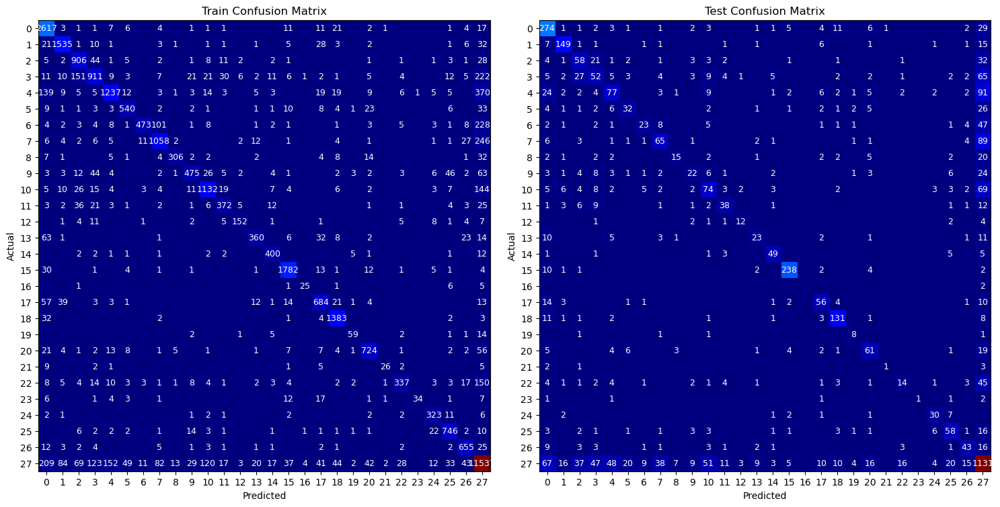

In [ ]:
# Evaluate on Train and Test sets
results = {}
confusion_matrices = {}
df4 = {}

for set_name, X, y in [('Train', X_train, y_train), ('Test', X_test, y_test)]:
    y_true, y_pred, y_prob = evaluate_model(gbt_model, gbt_tokenizer, X, y, batch_size=16)

    # Compute confusion matrix
    confusion_matrices[set_name] = confusion_matrix(y, y_pred)

    # Calculate metrics
    metrics, class_df = calculate_metrics_with_dataframe(y, y_pred, confusion_matrices[set_name], y_prob)
    results[set_name] = metrics
    df4[set_name] = class_df

# Print results
for set_name, metrics in results.items():
    print(f"Results for {set_name} Set:")
    for metric_name, value in metrics.items():
        print(f"  {metric_name.capitalize()}: {value:.4f}")
    print()

# Plot confusion matrices
fig, axes = plt.subplots(1, 2, figsize=(15, 8))

for i, (set_name, cm) in enumerate(confusion_matrices.items()):
    ax = axes[i]
    ax.imshow(cm, cmap=plt.cm.jet, interpolation='nearest')
    ax.set_title(f'{set_name} Confusion Matrix')
    ax.set_xlabel('Predicted')
    ax.set_ylabel('Actual')
    ax.grid(False)
    ax.set_xticks(np.arange(cm.shape[1]))
    ax.set_yticks(np.arange(cm.shape[0]))

    # Annotate the confusion matrix with counts
    for j in range(cm.shape[0]):
        for k in range(cm.shape[1]):
            count = cm[j, k]
            if count > 0:
                ax.text(k, j, str(count), ha='center', va='center', color='white', fontsize=9)

plt.tight_layout()
plt.show()

In [ ]:
for set, data in df4.items():
    print(set)
    display(data)

Train


,class,accuracy,precision,recall,f1
0,0,0.965683,0.798109,0.965683,0.873936
1,1,0.929177,0.892442,0.929177,0.910439
2,2,0.883902,0.734793,0.883902,0.802480
3,3,0.627843,0.741253,0.627843,0.679851
4,4,0.660438,0.839783,0.660438,0.739390
5,5,0.832049,0.843750,0.832049,0.837859
6,6,0.551282,0.942231,0.551282,0.695588
7,7,0.761699,0.821429,0.761699,0.790437
8,8,0.786632,0.927273,0.786632,0.851182
9,9,0.669958,0.824653,0.669958,0.739300


Test


,class,accuracy,precision,recall,f1
0,0,0.787356,0.578059,0.787356,0.666667
1,1,0.801075,0.776042,0.801075,0.788360
2,2,0.442748,0.376623,0.442748,0.407018
3,3,0.268041,0.313253,0.268041,0.288889
4,4,0.326271,0.466667,0.326271,0.384040
5,5,0.372093,0.470588,0.372093,0.415584
6,6,0.237113,0.534884,0.237113,0.328571
7,7,0.369318,0.492424,0.369318,0.422078
8,8,0.267857,0.555556,0.267857,0.361446
9,9,0.250000,0.440000,0.250000,0.318841


# Interactive View for Attention Matrix

In [41]:
def visualize_attention(model, tokenizer, text, display_mode="light"):
    inputs = tokenizer.encode(text, return_tensors='pt')
    outputs = model(inputs)

    attention = outputs[-1]

    tokens = tokenizer.convert_ids_to_tokens(inputs[0])

    model_view(attention, tokens, display_mode=display_mode)

## Pretrained Bert

In [48]:
pretrained_model.config.output_attentions = True
visualize_attention(pretrained_model, pretrained_tokenizer, correct_test[:1][0][0])

<IPython.core.display.Javascript object>

In [ ]:
visualize_attention(pretrained_model, pretrained_tokenizer, incorrect_test[:-1][0][0])

<IPython.core.display.Javascript object>

## Bert

In [51]:
visualize_attention(model, tokenizer, correct_test[:1][0][0])

<IPython.core.display.Javascript object>

In [64]:
correct_test[12]

('May regret asking but foid ?', 24, 24)

In [63]:
visualize_attention(model, tokenizer, correct_test[12][0])

<IPython.core.display.Javascript object>

In [67]:
incorrect_test[1]

("It's wonderful because it's awful. At not with.", 0, 11)

In [68]:
visualize_attention(model, tokenizer, incorrect_test[1][0])

<IPython.core.display.Javascript object>

## vis for pred for class 23
wrong for bert

In [16]:
text = "I’ve exposed on social media. It made me feel better so I don’t care what anyway has to say about it."
visualize_attention(model, tokenizer, text)

BertSdpaSelfAttention is used but `torch.nn.functional.scaled_dot_product_attention` does not support non-absolute `position_embedding_type` or `output_attentions=True` or `head_mask`. Falling back to the manual attention implementation, but specifying the manual implementation will be required from Transformers version v5.0.0 onwards. This warning can be removed using the argument `attn_implementation="eager"` when loading the model.


<IPython.core.display.Javascript object>

Correct for gbt2

In [19]:
# gbt2 performance
visualize_attention(gbt_model, gbt_tokenizer, text)

`GPT2SdpaAttention` is used but `torch.nn.functional.scaled_dot_product_attention` does not support `output_attentions=True` or `head_mask`. Falling back to the manual attention implementation, but specifying the manual implementation will be required from Transformers version v5.0.0 onwards. This warning can be removed using the argument `attn_implementation="eager"` when loading the model.


<IPython.core.display.Javascript object>

## GBT2

In [ ]:
gbt_model.config.output_attentions = True
visualize_attention(gbt_model, gbt_tokenizer, correct_test[:1][0][0])

`GPT2SdpaAttention` is used but `torch.nn.functional.scaled_dot_product_attention` does not support `output_attentions=True` or `head_mask`. Falling back to the manual attention implementation, but specifying the manual implementation will be required from Transformers version v5.0.0 onwards. This warning can be removed using the argument `attn_implementation="eager"` when loading the model.


<IPython.core.display.Javascript object>

In [ ]:
visualize_attention(gbt_model, gbt_tokenizer, incorrect_test[:-1][0][0])

<IPython.core.display.Javascript object>